In [1]:
#=import Pkg; 
Pkg.add(["IJulia", "CategoricalArrays", "LaTeXStrings",
        "CDMrdata",  "RDatasets",
        "CSV", "DataFrames",    
        "StatsBase", "StatsFuns",  "Distributions", 
        "Gadfly", "Plots", "StatsPlots",
        "Optim", "Turing", "MCMCChains", "DynamicPPL", "Zygote"
         ])
Pkg.update()
=#

In [2]:
using Distributions
using DataFrames
using Gadfly
using Turing
using StatsFuns
using Plots
using StatsPlots
using LinearAlgebra
using CategoricalArrays
using MCMCChains
using CSV
using CDMrdata

In [3]:
ENV["COLUMNS"] = 1000
ENV["LINES"] = 10
Threads.nthreads()

6

In [4]:
# Adding standard font sizes for all future graphs will make them much easier to read

latex_fonts = Theme(major_label_font="CMU Serif", major_label_font_size=22pt,
                   minor_label_font="CMU Serif", minor_label_font_size=16pt,
                   key_title_font="CMU Serif", key_title_font_size=18pt,
                   key_label_font="CMU Serif", key_label_font_size=16pt)
Gadfly.push_theme(latex_fonts)


In [5]:
# The number of samples is enough to create convergence later on, bigger is usually better but 600 is great
samples = 600
num_chains = 4

4

In [6]:
#=
This is the sample of students and the exam scores. There are 536 students represented through rows
and 15 questions as columns. A value of "1" indicates a question answered correctly and a value of "0"
an incorrect answer.
=#
X = DataFrame(CSV.File("final_project_Miguel.csv"))

,T01,T02,T03,T04,T05,T06,T07,T08,T09,T10,T11,T12,T13,T14,T15
,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64
1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1
2,0,1,1,1,1,0,1,1,1,1,1,1,1,1,0
3,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1
4,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0
5,1,1,1,0,0,1,1,1,1,1,1,1,1,0,0
6,0,0,1,0,1,0,0,1,1,0,1,0,0,0,0
7,1,1,1,0,0,1,1,1,1,1,1,0,1,1,1
8,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1
9,0,0,1,0,0,1,1,1,1,0,1,1,1,0,1


In [7]:
show(X, allrows = true, show_row_number = true)
# using this command we can individually check each student

536×15 DataFrame
 Row │ T01    T02    T03    T04    T05    T06    T07    T08    T09    T10    T ⋯
     │ Int64  Int64  Int64  Int64  Int64  Int64  Int64  Int64  Int64  Int64  I ⋯
─────┼──────────────────────────────────────────────────────────────────────────
   1 │     1      1      1      1      1      1      1      1      1      1    ⋯
   2 │     0      1      1      1      1      0      1      1      1      1
   3 │     1      1      1      1      1      1      1      1      1      1
   4 │     0      1      0      0      0      0      0      0      0      0
   5 │     1      1      1      0      0      1      1      1      1      1    ⋯
   6 │     0      0      1      0      1      0      0      1      1      0
   7 │     1      1      1      0      0      1      1      1      1      1
   8 │     1      1      1      1      1      1      1      1      1      1
   9 │     0      0      1      0      0      1      1      1      1      0    ⋯
  10 │     0      0      1      0      1 

In [8]:
I, J = size(X)
# Dimension here is due to the IRT model which uses "I" as the student dimension and "J" as the item/question dimension

(536, 15)

In [9]:
X_stacked = DataFrames.stack(X, All())
# This will convert the data to a long version so we can calculate the percentage attempts

,variable,value
,String,Int64
1,T01,1
2,T01,0
3,T01,1
4,T01,0
5,T01,1
6,T01,0
7,T01,1
8,T01,1
9,T01,0


In [10]:
X_grp = groupby(X_stacked, :variable)
# this will group each repetition of student's answers as one student
X_total_items = combine(X_grp, :value => (col -> (sum(col) / 536.0) * 100) => :percentage_attempts)
# Now we get the average by performing avg calculations on the column that was grouped, this gets our avg as a float

,variable,percentage_attempts
,String,Float64
1,T01,55.0373
2,T02,52.7985
3,T03,76.8657
4,T04,38.6194
5,T05,62.6866
6,T06,38.0597
7,T07,47.9478
8,T08,73.1343
9,T09,74.0672


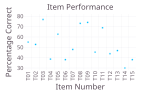

In [11]:
Gadfly.plot(X_total_items, x = :variable, y = :percentage_attempts, Geom.point,
Guide.xlabel("Item Number"), Guide.ylabel("Percentage Correct"), Guide.title("Item Performance")
)

#Using the gadfly package, I can now place each avg as the individual item performance.
#Each point represents the individual item's percentage correct

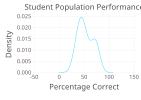

In [12]:
Gadfly.plot(X_total_items, x = :percentage_attempts, Geom.density,
Guide.xlabel("Percentage Correct"), Guide.ylabel("Density"), Guide.title("Student Population Performance")
)
#Here's a slightly different way to visualize the above graph, use a density graph to see a continous line 

In [13]:
function calc_likelihood(θ, d, aⱼ, c) # based on the 3-parameter IRT eqn, we'll use theta as "ability", d as "difficulty", etc
    

    Pₓ = c .+ (1 .- c).* logistic.(θ * aⱼ.-d) # The dots adjacent to the operators lets us distribute the operation to each element of the array
  
    return Pₓ
end

@model function irt_3pl_model(Xᵢ, I, J)
    
    θ ~ filldist(Normal(0,1), I,1) #theta is the i-th dimension since it refers to students. This prior indicates that student ability is average
    aⱼ ~ filldist(LogNormal(0,1), 1,J)
    d ~ filldist(Normal(1,1), 1,J) #Using 1,1 for the prior indicates that the test questions were "harder" than normal
    c ~ filldist(Beta(), 1,J)

    Pₓ = calc_likelihood(θ, d, aⱼ, c) 
    if (Xᵢ != nothing)
        Xᵢ .~ Bernoulli.(Pₓ)
    else
        X ~ arraydist(Bernoulli.(Pₓ))
    end
    return Pₓ
end


irt_3pl_model (generic function with 2 methods)

In [14]:
prior_chain = sample(irt_3pl_model(nothing, I, J), Prior(), samples) #we will sample 600 times from the above distributions
#This will be the basis prior chain 

Sampling: 100%|█████████████████████████████████████████| Time: 0:00:00


Chains MCMC chain (600×8622×1 Array{Float64, 3}):

Iterations        = 1:1:600
Number of chains  = 1
Samples per chain = 600
Wall duration     = 2.9 seconds
Compute duration  = 2.9 seconds
parameters        = θ[1,1], θ[2,1], θ[3,1], θ[4,1], θ[5,1], θ[6,1], θ[7,1], θ[8,1], θ[9,1], θ[10,1], θ[11,1], θ[12,1], θ[13,1], θ[14,1], θ[15,1], θ[16,1], θ[17,1], θ[18,1], θ[19,1], θ[20,1], θ[21,1], θ[22,1], θ[23,1], θ[24,1], θ[25,1], θ[26,1], θ[27,1], θ[28,1], θ[29,1], θ[30,1], θ[31,1], θ[32,1], θ[33,1], θ[34,1], θ[35,1], θ[36,1], θ[37,1], θ[38,1], θ[39,1], θ[40,1], θ[41,1], θ[42,1], θ[43,1], θ[44,1], θ[45,1], θ[46,1], θ[47,1], θ[48,1], θ[49,1], θ[50,1], θ[51,1], θ[52,1], θ[53,1], θ[54,1], θ[55,1], θ[56,1], θ[57,1], θ[58,1], θ[59,1], θ[60,1], θ[61,1], θ[62,1], θ[63,1], θ[64,1], θ[65,1], θ[66,1], θ[67,1], θ[68,1], θ[69,1], θ[70,1], θ[71,1], θ[72,1], θ[73,1], θ[74,1], θ[75,1], θ[76,1], θ[77,1], θ[78,1], θ[79,1], θ[80,1], θ[81,1], θ[82,1], θ[83,1], θ[84,1], θ[85,1], θ[86,1], θ[87,1], θ[88,1], θ[89,1],

In [15]:
df_prior = DataFrame(prior_chain) #this will place our chain in a dataframe
df_prior = DataFrames.stack(df_prior, Not(["iteration","chain","lp"])) #will convert to long format
subset!(df_prior, :variable => ByRow(x-> !contains(x, "θ") && !contains(x, "X")))#reframes the data so that each row is applied


,iteration,chain,lp,variable,value
,Int64,Int64,Float64,String,Float64
1,1,1,-4432.06,"aⱼ[1,1]",6.46012
2,2,1,-5128.91,"aⱼ[1,1]",0.984882
3,3,1,-4937.34,"aⱼ[1,1]",0.0294846
4,4,1,-4451.68,"aⱼ[1,1]",0.285898
5,5,1,-4842.62,"aⱼ[1,1]",3.12917
6,6,1,-5056.7,"aⱼ[1,1]",1.10833
7,7,1,-3833.14,"aⱼ[1,1]",0.829707
8,8,1,-4966.4,"aⱼ[1,1]",1.86604
9,9,1,-5071.16,"aⱼ[1,1]",0.458273


In [16]:
prior_plot = Gadfly.plot(df_prior, x=:value, y=:lp, Geom.point, color=:variable, Guide.xlabel("Data"), Guide.ylabel("Log Likelihood"))
#This command plots the parameters in the prior to see if they converge. If they don't, we shouldn't proceed

In [18]:
posterior_chain_nuts = sample(irt_3pl_model(Matrix(X), I, J), NUTS(), MCMCThreads(), samples, num_chains)
#for the posterior, we will sample from the prior distributions using NUTS algorithm!

┌ Info: Found initial step size
│   ϵ = 0.2
└ @ Turing.Inference C:\Users\m1gbr\.julia\packages\Turing\S4Y4B\src\inference\hmc.jl:188
┌ Info: Found initial step size
│   ϵ = 0.2
└ @ Turing.Inference C:\Users\m1gbr\.julia\packages\Turing\S4Y4B\src\inference\hmc.jl:188
┌ Info: Found initial step size
│   ϵ = 0.2
└ @ Turing.Inference C:\Users\m1gbr\.julia\packages\Turing\S4Y4B\src\inference\hmc.jl:188
┌ Info: Found initial step size
│   ϵ = 0.4
└ @ Turing.Inference C:\Users\m1gbr\.julia\packages\Turing\S4Y4B\src\inference\hmc.jl:188
┌ Warning: The current proposal will be rejected due to numerical error(s).
│   isfinite.((θ, r, ℓπ, ℓκ)) = (true, false, false, false)
└ @ AdvancedHMC C:\Users\m1gbr\.julia\packages\AdvancedHMC\51xgc\src\hamiltonian.jl:47
┌ Warning: The current proposal will be rejected due to numerical error(s).
│   isfinite.((θ, r, ℓπ, ℓκ)) = (true, false, false, false)
└ @ AdvancedHMC C:\Users\m1gbr\.julia\packages\AdvancedHMC\51xgc\src\hamiltonian.jl:47
┌ Warning: The cur

Chains MCMC chain (600×593×4 Array{Float64, 3}):

Iterations        = 301:1:900
Number of chains  = 4
Samples per chain = 600
Wall duration     = 6773.3 seconds
Compute duration  = 20108.36 seconds
parameters        = θ[1,1], θ[2,1], θ[3,1], θ[4,1], θ[5,1], θ[6,1], θ[7,1], θ[8,1], θ[9,1], θ[10,1], θ[11,1], θ[12,1], θ[13,1], θ[14,1], θ[15,1], θ[16,1], θ[17,1], θ[18,1], θ[19,1], θ[20,1], θ[21,1], θ[22,1], θ[23,1], θ[24,1], θ[25,1], θ[26,1], θ[27,1], θ[28,1], θ[29,1], θ[30,1], θ[31,1], θ[32,1], θ[33,1], θ[34,1], θ[35,1], θ[36,1], θ[37,1], θ[38,1], θ[39,1], θ[40,1], θ[41,1], θ[42,1], θ[43,1], θ[44,1], θ[45,1], θ[46,1], θ[47,1], θ[48,1], θ[49,1], θ[50,1], θ[51,1], θ[52,1], θ[53,1], θ[54,1], θ[55,1], θ[56,1], θ[57,1], θ[58,1], θ[59,1], θ[60,1], θ[61,1], θ[62,1], θ[63,1], θ[64,1], θ[65,1], θ[66,1], θ[67,1], θ[68,1], θ[69,1], θ[70,1], θ[71,1], θ[72,1], θ[73,1], θ[74,1], θ[75,1], θ[76,1], θ[77,1], θ[78,1], θ[79,1], θ[80,1], θ[81,1], θ[82,1], θ[83,1], θ[84,1], θ[85,1], θ[86,1], θ[87,1], θ[88,1],

In [19]:
predict_chain = predict(irt_3pl_model(nothing, I, J), #plugging in the model to see how the model will perform
posterior_chain_nuts[:,:,1], include_all=false); #this will pull out the first chain as an argument 
df_predict = DataFrame(predict_chain) #Now we can store the chain into a Dataframe

,iteration,chain,"X[1,1]","X[2,1]","X[3,1]","X[4,1]","X[5,1]","X[6,1]","X[7,1]","X[8,1]","X[9,1]","X[10,1]","X[11,1]","X[12,1]","X[13,1]","X[14,1]","X[15,1]","X[16,1]","X[17,1]","X[18,1]","X[19,1]","X[20,1]","X[21,1]","X[22,1]","X[23,1]","X[24,1]","X[25,1]","X[26,1]","X[27,1]","X[28,1]","X[29,1]","X[30,1]","X[31,1]","X[32,1]","X[33,1]","X[34,1]","X[35,1]","X[36,1]","X[37,1]","X[38,1]","X[39,1]","X[40,1]","X[41,1]","X[42,1]","X[43,1]","X[44,1]","X[45,1]","X[46,1]","X[47,1]","X[48,1]","X[49,1]","X[50,1]","X[51,1]","X[52,1]","X[53,1]","X[54,1]","X[55,1]","X[56,1]","X[57,1]","X[58,1]","X[59,1]","X[60,1]","X[61,1]","X[62,1]","X[63,1]","X[64,1]","X[65,1]","X[66,1]","X[67,1]","X[68,1]","X[69,1]","X[70,1]","X[71,1]","X[72,1]","X[73,1]","X[74,1]","X[75,1]","X[76,1]","X[77,1]","X[78,1]","X[79,1]","X[80,1]","X[81,1]","X[82,1]","X[83,1]","X[84,1]","X[85,1]","X[86,1]","X[87,1]","X[88,1]","X[89,1]","X[90,1]","X[91,1]","X[92,1]","X[93,1]","X[94,1]","X[95,1]","X[96,1]","X[97,1]","X[98,1]","X[99,1]","X[100,1]","X[101,1]","X[102,1]","X[103,1]","X[104,1]","X[105,1]","X[106,1]","X[107,1]","X[108,1]","X[109,1]"
,Int64,Int64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64
1,1,1,1.0,1.0,1.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
2,2,1,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,1.0,1.0,1.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,1.0,1.0,1.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,1.0,1.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0
3,3,1,0.0,1.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0
4,4,1,1.0,1.0,1.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0
5,5,1,1.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0

In [21]:
select!(df_predict, r"X") #this excludes the iterations and chain column so we can combine the rest of the columns accurately

,"X[1,1]","X[2,1]","X[3,1]","X[4,1]","X[5,1]","X[6,1]","X[7,1]","X[8,1]","X[9,1]","X[10,1]","X[11,1]","X[12,1]","X[13,1]","X[14,1]","X[15,1]","X[16,1]","X[17,1]","X[18,1]","X[19,1]","X[20,1]","X[21,1]","X[22,1]","X[23,1]","X[24,1]","X[25,1]","X[26,1]","X[27,1]","X[28,1]","X[29,1]","X[30,1]","X[31,1]","X[32,1]","X[33,1]","X[34,1]","X[35,1]","X[36,1]","X[37,1]","X[38,1]","X[39,1]","X[40,1]","X[41,1]","X[42,1]","X[43,1]","X[44,1]","X[45,1]","X[46,1]","X[47,1]","X[48,1]","X[49,1]","X[50,1]","X[51,1]","X[52,1]","X[53,1]","X[54,1]","X[55,1]","X[56,1]","X[57,1]","X[58,1]","X[59,1]","X[60,1]","X[61,1]","X[62,1]","X[63,1]","X[64,1]","X[65,1]","X[66,1]","X[67,1]","X[68,1]","X[69,1]","X[70,1]","X[71,1]","X[72,1]","X[73,1]","X[74,1]","X[75,1]","X[76,1]","X[77,1]","X[78,1]","X[79,1]","X[80,1]","X[81,1]","X[82,1]","X[83,1]","X[84,1]","X[85,1]","X[86,1]","X[87,1]","X[88,1]","X[89,1]","X[90,1]","X[91,1]","X[92,1]","X[93,1]","X[94,1]","X[95,1]","X[96,1]","X[97,1]","X[98,1]","X[99,1]","X[100,1]","X[101,1]","X[102,1]","X[103,1]","X[104,1]","X[105,1]","X[106,1]","X[107,1]","X[108,1]","X[109,1]","X[110,1]"
,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64
1,1.0,1.0,1.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0
2,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,1.0,1.0,1.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,1.0,1.0,1.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,1.0,1.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0
3,0.0,1.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0
4,1.0,1.0,1.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0
5,1.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,1.

In [22]:
x_predict = combine(df_predict, All() .=> mode) #now we can see the correct answers for each item for each student in a wide format

,"X[1,1]_mode","X[2,1]_mode","X[3,1]_mode","X[4,1]_mode","X[5,1]_mode","X[6,1]_mode","X[7,1]_mode","X[8,1]_mode","X[9,1]_mode","X[10,1]_mode","X[11,1]_mode","X[12,1]_mode","X[13,1]_mode","X[14,1]_mode","X[15,1]_mode","X[16,1]_mode","X[17,1]_mode","X[18,1]_mode","X[19,1]_mode","X[20,1]_mode","X[21,1]_mode","X[22,1]_mode","X[23,1]_mode","X[24,1]_mode","X[25,1]_mode","X[26,1]_mode","X[27,1]_mode","X[28,1]_mode","X[29,1]_mode","X[30,1]_mode","X[31,1]_mode","X[32,1]_mode","X[33,1]_mode","X[34,1]_mode","X[35,1]_mode","X[36,1]_mode","X[37,1]_mode","X[38,1]_mode","X[39,1]_mode","X[40,1]_mode","X[41,1]_mode","X[42,1]_mode","X[43,1]_mode","X[44,1]_mode","X[45,1]_mode","X[46,1]_mode","X[47,1]_mode","X[48,1]_mode","X[49,1]_mode","X[50,1]_mode","X[51,1]_mode","X[52,1]_mode","X[53,1]_mode","X[54,1]_mode","X[55,1]_mode","X[56,1]_mode","X[57,1]_mode","X[58,1]_mode","X[59,1]_mode","X[60,1]_mode","X[61,1]_mode","X[62,1]_mode","X[63,1]_mode","X[64,1]_mode","X[65,1]_mode","X[66,1]_mode","X[67,1]_mode","X[68,1]_mode","X[69,1]_mode","X[70,1]_mode","X[71,1]_mode","X[72,1]_mode","X[73,1]_mode"
,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64
1,1.0,1.0,1.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,1.0,1.0,1.0,1.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,1.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0


In [23]:
reshape(Matrix(x_predict), (I,J)) #now the array will reshape to the dimensions IxJ

536×15 Matrix{Float64}:
 1.0  1.0  1.0  1.0  1.0  1.0  1.0  1.0  1.0  1.0  1.0  1.0  1.0  1.0  1.0
 1.0  1.0  1.0  1.0  1.0  1.0  1.0  1.0  1.0  1.0  1.0  1.0  1.0  0.0  1.0
 1.0  1.0  1.0  1.0  1.0  1.0  1.0  1.0  1.0  1.0  1.0  1.0  1.0  1.0  1.0
 ⋮                        ⋮                        ⋮                   
 1.0  1.0  1.0  1.0  1.0  1.0  1.0  1.0  1.0  1.0  1.0  1.0  1.0  1.0  1.0
 0.0  0.0  1.0  0.0  1.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0

In [24]:
x_predict = DataFrame(reshape(Matrix(x_predict), (I,J)), string.("T", string.(1:J, pad = 2)))
#plugging in the reshape into a dataframe and clarifying each column as a test item/question

,T01,T02,T03,T04,T05,T06,T07,T08,T09,T10,T11,T12,T13,T14,T15
,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64
1,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
2,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0
3,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0
6,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0
7,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
8,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
9,1.0,1.0,1.0,1.0,1.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0


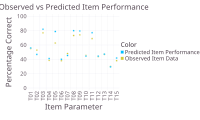

In [28]:
#using similar logic in the item performance graph in ln 11, we stack the predicted data and group by variables to perform
#avg calculations, then we stack two layers into gadfly, with the first argument being the predicted and the second the actual
#item performance seen in ln 11. Notice the discrepancy between the dots, they mean that the prediction is not spot on.

X_stacked_pred = DataFrames.stack(x_predict, All())

X_grp_pred = groupby(X_stacked_pred, :variable)
X_total_items_pred = combine(X_grp_pred, :value => (col -> (sum(col) / 536.0) * 100) => :percentage_attempts)

set_default_plot_size(20cm, 12cm) 

Gadfly.plot(layer(X_total_items_pred, x = :variable, y = :percentage_attempts, Geom.point, color = ["Predicted Item Performance"]),
    layer(X_total_items, x = :variable, y = :percentage_attempts, Geom.point, color = ["Observed Item Data"]),
Guide.xlabel("Item Parameter"), Guide.ylabel("Percentage Correct"), Guide.title("Observed vs Predicted Item Performance")
)


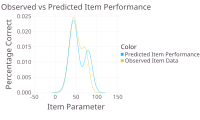

In [30]:
#Similar to the Student population performance graph from earlier, we compared how the predicted and observed data relate
#in a continuous line by creating two layers. Notice the gap in the 60th- 75th parameter.

Gadfly.plot(layer(X_total_items_pred, x = :percentage_attempts, Geom.density, color = ["Predicted Item Performance"]),
    layer(X_total_items, x = :percentage_attempts, Geom.density, color = ["Observed Item Data"]),
Guide.xlabel("Item Parameter"), Guide.ylabel("Percentage Correct"), Guide.title("Observed vs Predicted Item Performance")
)

In [36]:
df_posterior_chain_nuts = DataFrame(describe(posterior_chain_nuts)[1])
df_parameter = transform(df_posterior_chain_nuts, :parameters => ByRow(x -> string(string.(x)[1])) => :parameter_type)
#We want to store the first chain as a dataframe so we can gather the rhat measurement later on for convergence

,parameters,mean,std,naive_se,mcse,ess,rhat,ess_per_sec,parameter_type
,Symbol,Float64,Float64,Float64,Float64,Float64,Float64,Float64,String
1,"θ[1,1]",1.50731,0.518011,0.0105739,0.0128713,1456.99,1.00031,0.0724568,θ
2,"θ[2,1]",0.535635,0.166444,0.00339753,0.0038153,2058.14,1.00191,0.102352,θ
3,"θ[3,1]",1.50438,0.51266,0.0104646,0.00990403,2123.64,0.999684,0.10561,θ
4,"θ[4,1]",-1.66624,0.543151,0.011087,0.00951168,1935.95,0.999934,0.0962758,θ
5,"θ[5,1]",0.517716,0.173062,0.00353261,0.00395852,1846.81,0.999925,0.0918431,θ
6,"θ[6,1]",-0.355055,0.257243,0.00525095,0.00597132,1853.04,1.00038,0.0921527,θ
7,"θ[7,1]",0.699143,0.216529,0.00441989,0.00533156,1627.69,0.998899,0.0809458,θ
8,"θ[8,1]",1.50149,0.509104,0.010392,0.010736,1825.42,0.998949,0.0907793,θ
9,"θ[9,1]",0.3576,0.166948,0.00340781,0.00330385,2421.07,1.00051,0.120401,θ


In [37]:
show(df_posterior_chain_nuts, allrows=true) #this will come in handy to check which parameters are converging e.g theta, d, c

581×8 DataFrame
 Row │ parameters  mean         std         naive_se     mcse         ess      ⋯
     │ Symbol      Float64      Float64     Float64      Float64      Float64  ⋯
─────┼──────────────────────────────────────────────────────────────────────────
   1 │ θ[1,1]       1.50731     0.518011    0.0105739    0.0128713    1456.99  ⋯
   2 │ θ[2,1]       0.535635    0.166444    0.00339753   0.0038153    2058.14
   3 │ θ[3,1]       1.50438     0.51266     0.0104646    0.00990403   2123.64
   4 │ θ[4,1]      -1.66624     0.543151    0.011087     0.00951168   1935.95
   5 │ θ[5,1]       0.517716    0.173062    0.00353261   0.00395852   1846.81  ⋯
   6 │ θ[6,1]      -0.355055    0.257243    0.00525095   0.00597132   1853.04
   7 │ θ[7,1]       0.699143    0.216529    0.00441989   0.00533156   1627.69
   8 │ θ[8,1]       1.50149     0.509104    0.010392     0.010736     1825.42
   9 │ θ[9,1]       0.3576      0.166948    0.00340781   0.00330385   2421.07  ⋯
  10 │ θ[10,1]     -0.334245  

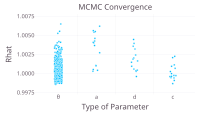

In [41]:
#since rhat values close to 0 means that the parameters have converged, we want to see how each one performed by setting the x 
#to parameters from above and y to rhat itself. hstack rearranges the plots to see them more clearly
h = Gadfly.plot(df_parameter, x = :parameter_type, y = :rhat, Geom.point,
Guide.xlabel("Type of Parameter"), Guide.ylabel("Rhat"), Guide.title("MCMC Convergence"), Stat.x_jitter(range=0.2),
)
hstack(h)

In [43]:
df_posterior_theta_mean = df_posterior_chain_nuts[1:536,1:2] #this will retrieve the correct columns for theta mean
for i in 1:536 #this loop will iterate through each row and assign the correct students' ability posterior
    df_posterior_theta_mean[i, 1] = Symbol.(i)
end
df_posterior_theta_mean

,parameters,mean
,Symbol,Float64
1,1,1.50731
2,2,0.535635
3,3,1.50438
4,4,-1.66624
5,5,0.517716
6,6,-0.355055
7,7,0.699143
8,8,1.50149
9,9,0.3576


In [44]:
df_prior_theta_mean = DataFrame(describe(prior_chain)[1])[1:536, 1:2] #this will access the correct columns from the prior chain
for i in 1:536 #same concept as in cell before
    df_prior_theta_mean[i, 1] = Symbol.(i)
end
df_prior_theta_mean

,parameters,mean
,Symbol,Float64
1,1,-0.0260948
2,2,-0.00861989
3,3,-0.0294754
4,4,-0.0035894
5,5,0.0519582
6,6,0.0270646
7,7,-0.00137275
8,8,0.065195
9,9,0.00374794


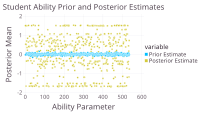

In [45]:
#By stacking two layers (prior and posterior estimates) we can see generally across all points if the posterior has diverged from
#the prior, whhich it should for Bayesian probability
ind_prob_plot = Gadfly.plot(
    layer(df_prior_theta_mean, x = 1:nrow(df_prior_theta_mean), y =:mean, Geom.point, color = ["Prior Estimate"]),
    layer(df_posterior_theta_mean, x = 1:nrow(df_posterior_theta_mean), y =:mean, Geom.point, color = ["Posterior Estimate"]),
    Guide.xlabel("Ability Parameter"), Guide.ylabel("Posterior Mean"), Guide.colorkey("variable"), Guide.Title("Student Ability Prior and Posterior Estimates")
)

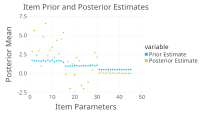

In [46]:
#to analyze free parameters, we used the similar retrieval of the posterior chain and prior chain, only now
#we want to correctly retrieve rows 537-581 and iterate through 45 times since there's 15 questions on the test * 3 parameters
#we exclude the ability parameter since we want to evaluate the testing parameters and how much they diverged from the prior
item_parameters_prior = DataFrame(describe(prior_chain)[1])[537:581, 1:2]
item_parameters_prior.item_num = 1:45

item_parameters_posterior = df_posterior_chain_nuts[537:581, :]
item_parameters_posterior = item_parameters_posterior[:, 1:2]
item_parameters_posterior.item_num = 1:45

#graphing
ind_prob_plot = Gadfly.plot(
    layer(item_parameters_prior, x =:item_num, y =:mean, Geom.point, color = ["Prior Estimate"]),
    layer(item_parameters_posterior, x =:item_num, y =:mean, Geom.point, color = ["Posterior Estimate"]),
    Guide.xlabel("Item Parameters"), Guide.ylabel("Posterior Mean"), Guide.colorkey("variable"), Guide.Title("Item Prior and Posterior Estimates")
)

In [47]:
show(DataFrame(describe(prior_chain)[1])) #to prepare for the ability vs. difficulty curve, we need to first check
#if we have the "summary statistics" chain

8621×8 DataFrame
  Row │ parameters  mean         std       naive_se   mcse       ess      rhat ⋯
      │ Symbol      Float64      Float64   Float64    Float64    Float64  Floa ⋯
──────┼─────────────────────────────────────────────────────────────────────────
    1 │ θ[1,1]      -0.0260948   0.983345  0.0401449  0.0321741  623.265  0.99 ⋯
    2 │ θ[2,1]      -0.00861989  1.01545   0.0414557  0.0357561  559.554  0.99
    3 │ θ[3,1]      -0.0294754   1.03031   0.0420624  0.0375801  728.796  0.99
    4 │ θ[4,1]      -0.0035894   1.01546   0.0414559  0.0412413  618.105  0.99
    5 │ θ[5,1]       0.0519582   0.983269  0.0401418  0.0447881  554.316  1.00 ⋯
    6 │ θ[6,1]       0.0270646   0.990829  0.0404504  0.0432794  599.881  0.99
    7 │ θ[7,1]      -0.00137275  0.989831  0.0404097  0.0411689  553.809  0.99
    8 │ θ[8,1]       0.065195    1.01669   0.0415063  0.0360976  578.428  0.99
    9 │ θ[9,1]       0.00374794  1.00288   0.0409424  0.0332371  568.065  0.99 ⋯
   10 │ θ[10,1]     -0.

In [48]:
show(DataFrame(describe(prior_chain)[1])[537:581,:],allrows=true) #this will help us find specific examples of students
#that performed avg and students who performed well

45×8 DataFrame
 Row │ parameters  mean      std       naive_se   mcse        ess      rhat    ⋯
     │ Symbol      Float64   Float64   Float64    Float64     Float64  Float64 ⋯
─────┼──────────────────────────────────────────────────────────────────────────
   1 │ aⱼ[1,1]     1.75552   2.43245   0.0993044  0.0868066   562.733  0.99848 ⋯
   2 │ aⱼ[1,2]     1.63715   1.98428   0.081008   0.0785563   603.847  0.99850
   3 │ aⱼ[1,3]     1.658     2.13351   0.0871002  0.0895498   597.656  0.99849
   4 │ aⱼ[1,4]     1.63582   2.15988   0.0881768  0.0831772   683.079  0.99931
   5 │ aⱼ[1,5]     1.57064   2.13844   0.0873013  0.0857234   645.421  0.99849 ⋯
   6 │ aⱼ[1,6]     1.7073    2.28002   0.0930814  0.0868773   525.372  0.99966
   7 │ aⱼ[1,7]     1.60843   2.0637    0.0842504  0.0822223   648.635  1.00136
   8 │ aⱼ[1,8]     1.75744   2.1004    0.0857486  0.0929434   564.776  0.99896
   9 │ aⱼ[1,9]     1.60283   2.13818   0.0872907  0.0736341   574.946  1.00472 ⋯
  10 │ aⱼ[1,10]    1.7319

In [49]:
df_difficulty = df_posterior_chain_nuts[552:566, :] #this will be used as the dataframe for one layer
#of the difficulty vs. ability graph

,parameters,mean,std,naive_se,mcse,ess,rhat,ess_per_sec
,Symbol,Float64,Float64,Float64,Float64,Float64,Float64,Float64
1,"d[1,1]",-0.121636,0.178118,0.00363582,0.00672985,608.335,1.00057,0.0302529
2,"d[1,2]",1.56886,0.404911,0.0082652,0.0146613,797.293,1.0032,0.0396498
3,"d[1,3]",-1.98988,0.206372,0.00421254,0.00637229,856.209,1.00187,0.0425798
4,"d[1,4]",1.24075,0.219332,0.00447709,0.00749392,783.619,1.00035,0.0389698
5,"d[1,5]",-0.171521,0.328872,0.00671308,0.0103495,754.474,1.00043,0.0375204
6,"d[1,6]",2.08006,0.331263,0.00676188,0.0104381,909.878,0.999595,0.0452488
7,"d[1,7]",1.65122,0.477822,0.00975349,0.0183395,729.408,1.00445,0.0362739
8,"d[1,8]",-1.59025,0.182569,0.00372668,0.00558187,952.57,1.00147,0.0473719
9,"d[1,9]",-2.01831,0.236784,0.00483333,0.00780418,834.871,1.00357,0.0415186


In [50]:
df_ability = DataFrame(df_posterior_chain_nuts[515, :]) #student who performed well
#we discovered this student from an earlier analysis of student performance, the slideshow will showcase this

,parameters,mean,std,naive_se,mcse,ess,rhat,ess_per_sec
,Symbol,Float64,Float64,Float64,Float64,Float64,Float64,Float64
1,"θ[515,1]",1.51582,0.538875,0.0109997,0.0135653,1385.19,1.00191,0.0688863


In [51]:
df_ability_avg = DataFrame(df_posterior_chain_nuts[504, :])# this is a student who performed poorly

,parameters,mean,std,naive_se,mcse,ess,rhat,ess_per_sec
,Symbol,Float64,Float64,Float64,Float64,Float64,Float64,Float64
1,"θ[504,1]",-1.67875,0.569286,0.0116205,0.00929574,2656.3,0.999157,0.132099


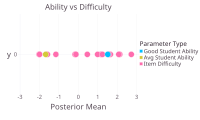

In [53]:
#we layered the mean columns of the avg student and the good student as well as the difficulty of each item.
#we wanted to use dots on a x-axis to display the distance between the good student and the bad.
#the student dot can only answer questions to the left, so this indicates a good measuring of difficulty
ind_prob_plot = Gadfly.plot(
    layer(df_ability, x =:mean, y =[0], Geom.point, color = ["Good Student Ability"]),
    layer(df_ability_avg, x =:mean, y =[0], Geom.point, color = ["Avg Student Ability"]),
    layer(df_difficulty, x =:mean, y =repeat([0], nrow(df_difficulty)), Geom.point, color = ["Item Difficulty"]), size = [3mm],
    Guide.xlabel("Posterior Mean"), Guide.ylabel("y"), Guide.colorkey("Parameter Type"), Guide.Title("Ability vs Difficulty")
)
hstack(ind_prob_plot)

In [61]:
item_param = r"dⱼ|aⱼ|cⱼ"
item = r"\[1,1\]"
df_item_posterior_mean = subset(DataFrame(describe(posterior_chain_nuts)[1]), :parameters => ByRow(x->contains(string(x),item_param)))
#here we want to retrieve the mean by accessing the paramater column from chain 1 of posterior and input the parameters of IRT

df_ability_results = DataFrame(describe(posterior_chain_nuts)[1])
subset!(df_ability_results, :parameters => ByRow(x->contains(string(x), "θ")))
#We want to retain the same dimension of array but now isolate the theta or "ability" results




,parameters,mean,std,naive_se,mcse,ess,rhat,ess_per_sec
,Symbol,Float64,Float64,Float64,Float64,Float64,Float64,Float64
1,"θ[1,1]",1.50731,0.518011,0.0105739,0.0128713,1456.99,1.00031,0.0724568
2,"θ[2,1]",0.535635,0.166444,0.00339753,0.0038153,2058.14,1.00191,0.102352
3,"θ[3,1]",1.50438,0.51266,0.0104646,0.00990403,2123.64,0.999684,0.10561
4,"θ[4,1]",-1.66624,0.543151,0.011087,0.00951168,1935.95,0.999934,0.0962758
5,"θ[5,1]",0.517716,0.173062,0.00353261,0.00395852,1846.81,0.999925,0.0918431
6,"θ[6,1]",-0.355055,0.257243,0.00525095,0.00597132,1853.04,1.00038,0.0921527
7,"θ[7,1]",0.699143,0.216529,0.00441989,0.00533156,1627.69,0.998899,0.0809458
8,"θ[8,1]",1.50149,0.509104,0.010392,0.010736,1825.42,0.998949,0.0907793
9,"θ[9,1]",0.3576,0.166948,0.00340781,0.00330385,2421.07,1.00051,0.120401


In [62]:
df_item_curve = transform(df_ability_results, :mean => (x -> calc_likelihood(x, df_item_posterior_mean[1,2], df_item_posterior_mean[2,2], df_item_posterior_mean[3,2])) => :likelihood)
#the transform function lets us use our calc_likelihood function to use as an argument to see if ability results can be plugged into the model

,parameters,mean,std,naive_se,mcse,ess,rhat,ess_per_sec,likelihood
,Symbol,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64
1,"θ[1,1]",1.50731,0.518011,0.0105739,0.0128713,1456.99,1.00031,0.0724568,1.005
2,"θ[2,1]",0.535635,0.166444,0.00339753,0.0038153,2058.14,1.00191,0.102352,1.63273
3,"θ[3,1]",1.50438,0.51266,0.0104646,0.00990403,2123.64,0.999684,0.10561,1.00508
4,"θ[4,1]",-1.66624,0.543151,0.011087,0.00951168,1935.95,0.999934,0.0962758,2.3492
5,"θ[5,1]",0.517716,0.173062,0.00353261,0.00395852,1846.81,0.999925,0.0918431,1.66671
6,"θ[6,1]",-0.355055,0.257243,0.00525095,0.00597132,1853.04,1.00038,0.0921527,2.33914
7,"θ[7,1]",0.699143,0.216529,0.00441989,0.00533156,1627.69,0.998899,0.0809458,1.35108
8,"θ[8,1]",1.50149,0.509104,0.010392,0.010736,1825.42,0.998949,0.0907793,1.00516
9,"θ[9,1]",0.3576,0.166948,0.00340781,0.00330385,2421.07,1.00051,0.120401,1.9531


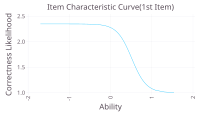

In [65]:
Gadfly.plot(df_item_curve, x=:mean, y=:likelihood, Geom.line, Guide.ylabel("Correctness Likelihood"), Guide.xlabel("Ability"), Guide.title("Item Characteristic Curve(1st Item)"))
#finally, by using the model's likelihood function, we can see that as ability increases, the probability of endorsing
# a correct answer diminishes. This is quite the opposite of what we were aiming to capture with IRT, so as a
# "business" decision, we decided not to recommend IRT 3-parameter for potential clients who want to analyze student and 
#item performance.